In [1]:
import numpy as np
from astropy.io import ascii
import matplotlib.pyplot as plt
import ast
from panoptes_client import Panoptes, Subject
from skimage import io
import getpass
%matplotlib inline

Broken libmagic installation detected. The python-magic module is installed but can't be imported. Please check that both python-magic and the libmagic shared library are installed correctly. Uploading media other than images may not work.


In [2]:
username = getpass.getpass('Username:')
password = getpass.getpass('Password:')
Panoptes.connect(username=username, password=password)

Username:········
Password:········


In [13]:
file = 'point_reducer_hdbscan_proposed.csv'
data = ascii.read(file, delimiter=',')
print(data.colnames)

['subject_id', 'workflow_id', 'task', 'reducer', 'data.aggregation_version', 'data.frame0.T1_tool1_points_x', 'data.frame0.T1_tool1_points_y', 'data.frame0.T1_tool1_cluster_labels', 'data.frame0.T1_tool1_cluster_probabilities', 'data.frame0.T1_tool1_clusters_persistance', 'data.frame0.T1_tool1_clusters_count', 'data.frame0.T1_tool1_clusters_x', 'data.frame0.T1_tool1_clusters_y', 'data.frame0.T1_tool1_clusters_var_x', 'data.frame0.T1_tool1_clusters_var_y', 'data.frame0.T1_tool1_clusters_var_x_y', 'data.frame0.T5_tool1_points_x', 'data.frame0.T5_tool1_points_y', 'data.frame0.T5_tool1_cluster_labels', 'data.frame0.T5_tool1_cluster_probabilities', 'data.frame0.T5_tool1_clusters_persistance', 'data.frame0.T5_tool1_clusters_count', 'data.frame0.T5_tool1_clusters_x', 'data.frame0.T5_tool1_clusters_y', 'data.frame0.T5_tool1_clusters_var_x', 'data.frame0.T5_tool1_clusters_var_y', 'data.frame0.T5_tool1_clusters_var_x_y', 'data.frame0.T5_tool0_points_x', 'data.frame0.T5_tool0_points_y', 'data.fra

In [30]:
task_T1 = data['task']=='T1'
data_T1 = data[:][task_T1]

data_T1['data.frame0.T1_tool1_clusters_x'].fill_value = 'None'
data_T1['data.frame0.T1_tool1_clusters_y'].fill_value = 'None'
data_T1['data.frame0.T1_tool0_clusters_x'].fill_value = 'None'
data_T1['data.frame0.T1_tool0_clusters_y'].fill_value = 'None'

In [22]:
clustered_points_mask = (data_T1['data.frame0.T1_tool0_clusters_x'].filled()!='None')&(data_T1['data.frame0.T1_tool1_clusters_x'].filled()!='None')

clustered_subs = data_T1['subject_id'][clustered_points_mask]

points0_x   = data_T1['data.frame0.T1_tool0_points_x'][clustered_points_mask]
points0_y   = data_T1['data.frame0.T1_tool0_points_y'][clustered_points_mask]
clusters0_x = data_T1['data.frame0.T1_tool0_clusters_x'][clustered_points_mask]
clusters0_y = data_T1['data.frame0.T1_tool0_clusters_y'][clustered_points_mask]

points1_x   = data_T1['data.frame0.T1_tool1_points_x'][clustered_points_mask]
points1_y   = data_T1['data.frame0.T1_tool1_points_y'][clustered_points_mask]
clusters1_x = data_T1['data.frame0.T1_tool1_clusters_x'][clustered_points_mask]
clusters1_y = data_T1['data.frame0.T1_tool1_clusters_y'][clustered_points_mask]

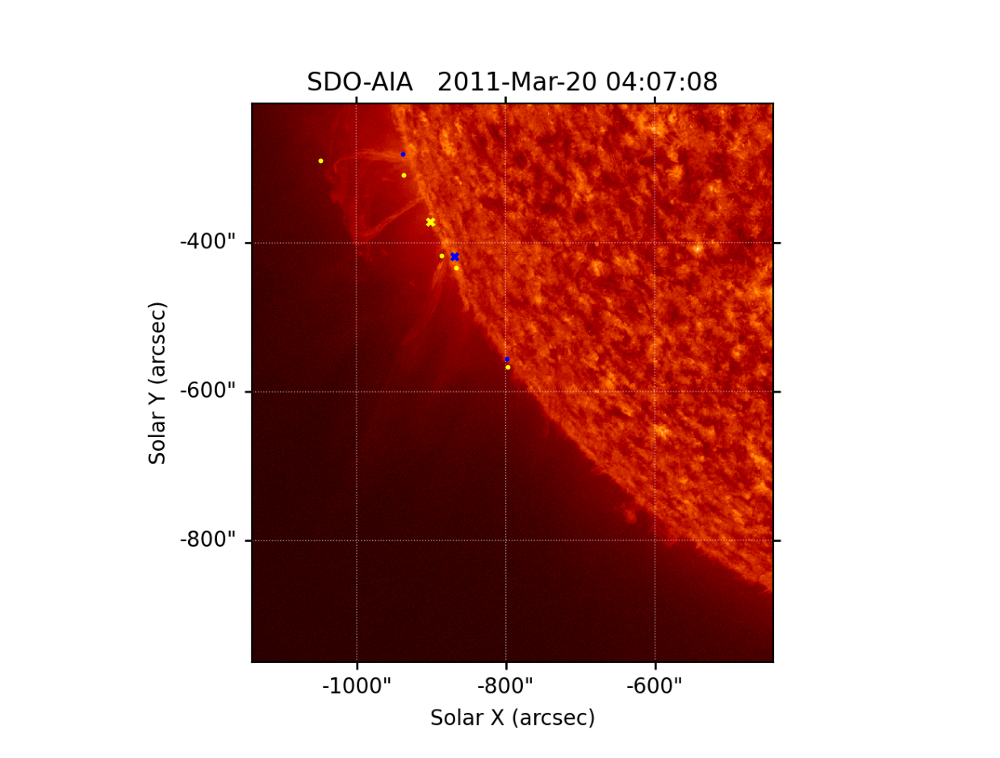

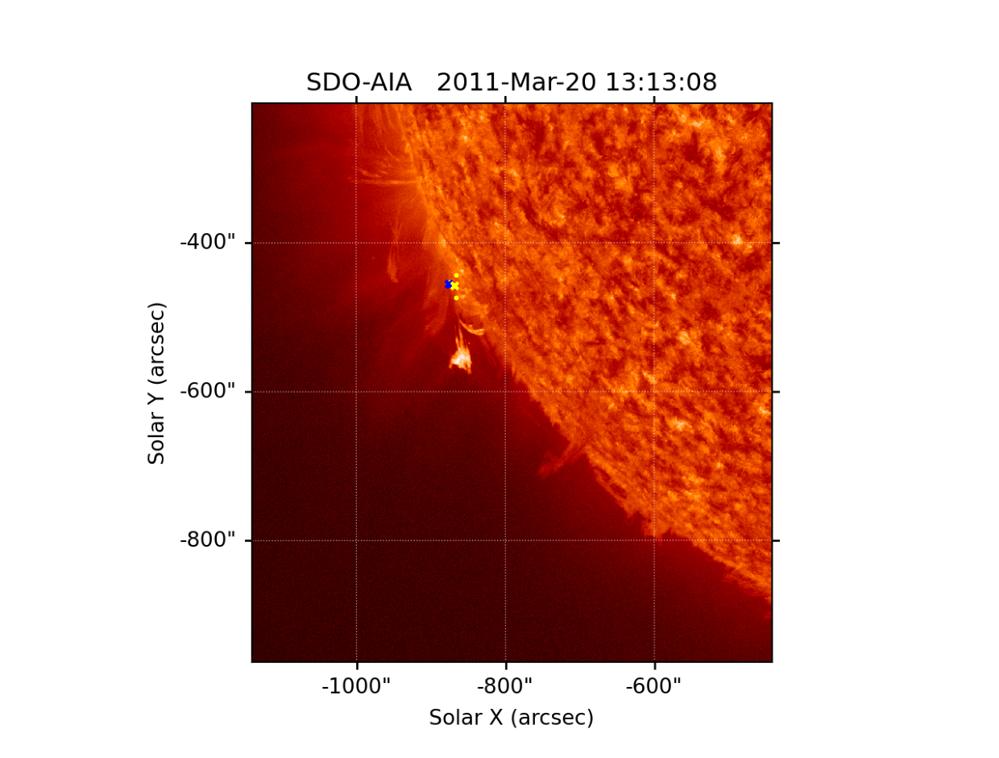

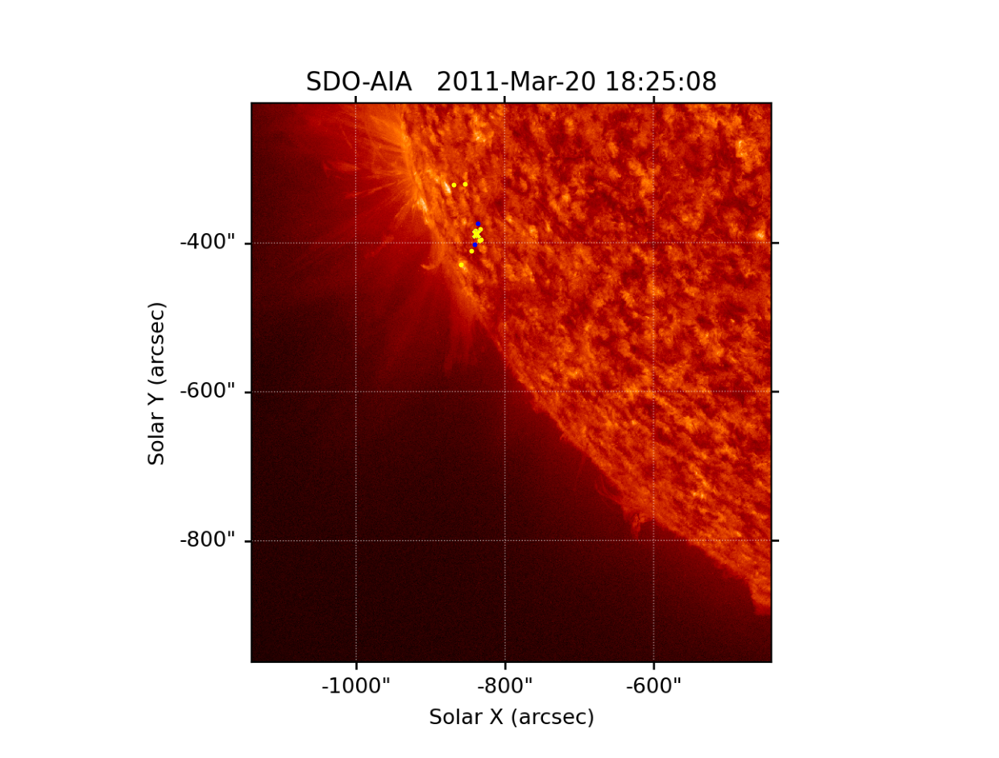

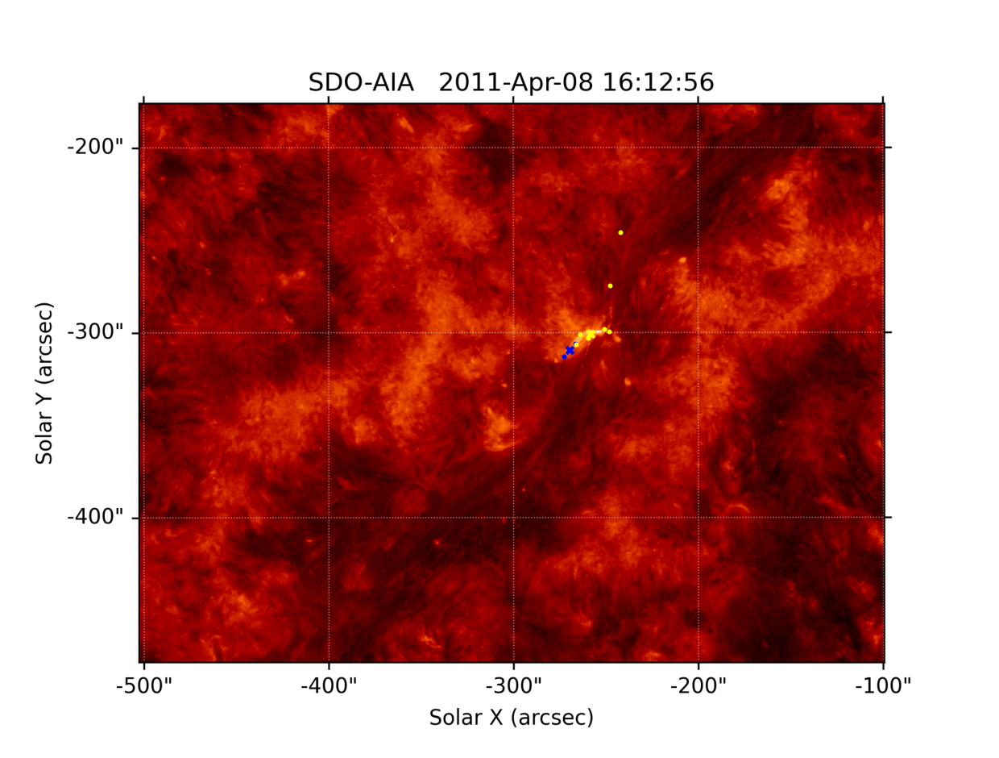

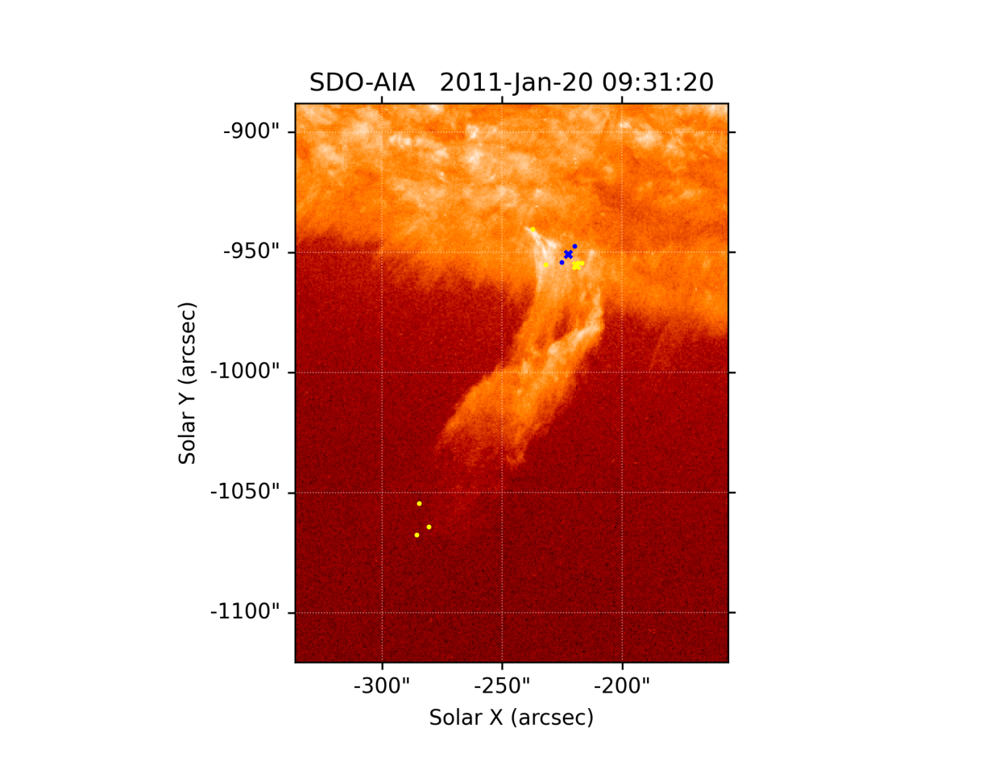

...

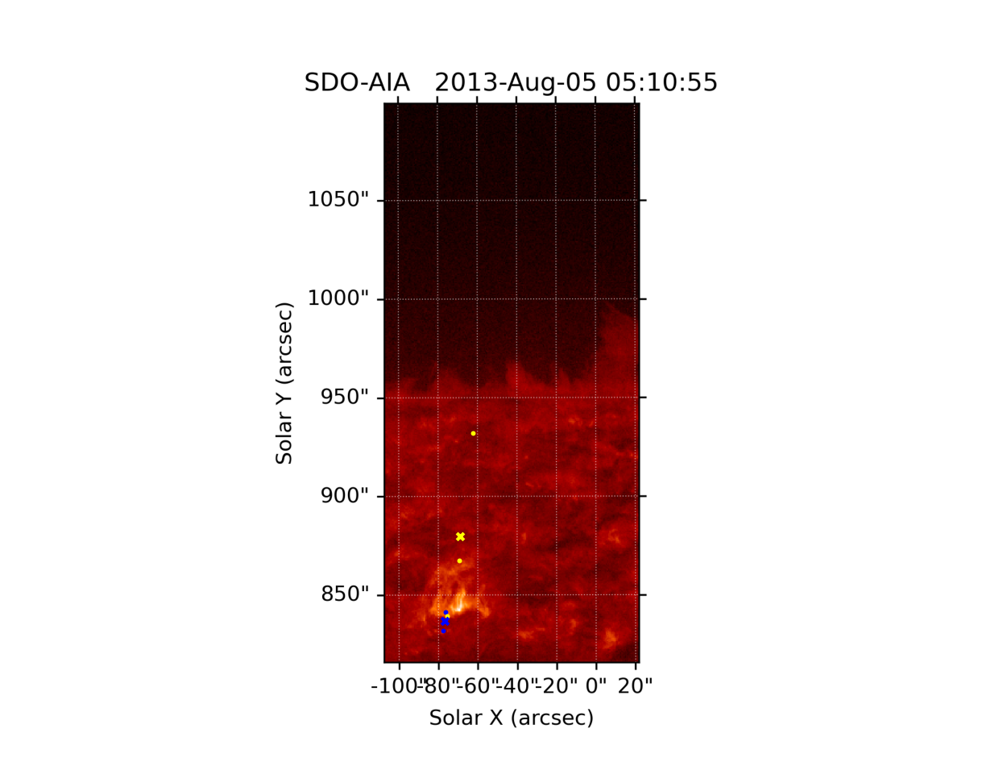

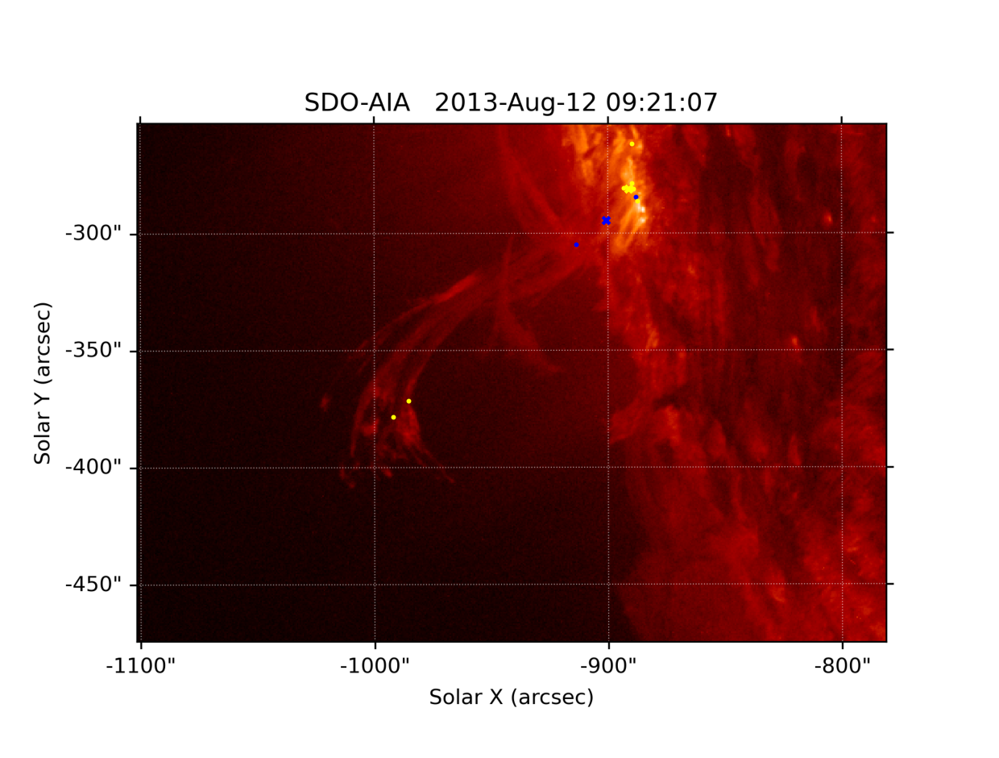

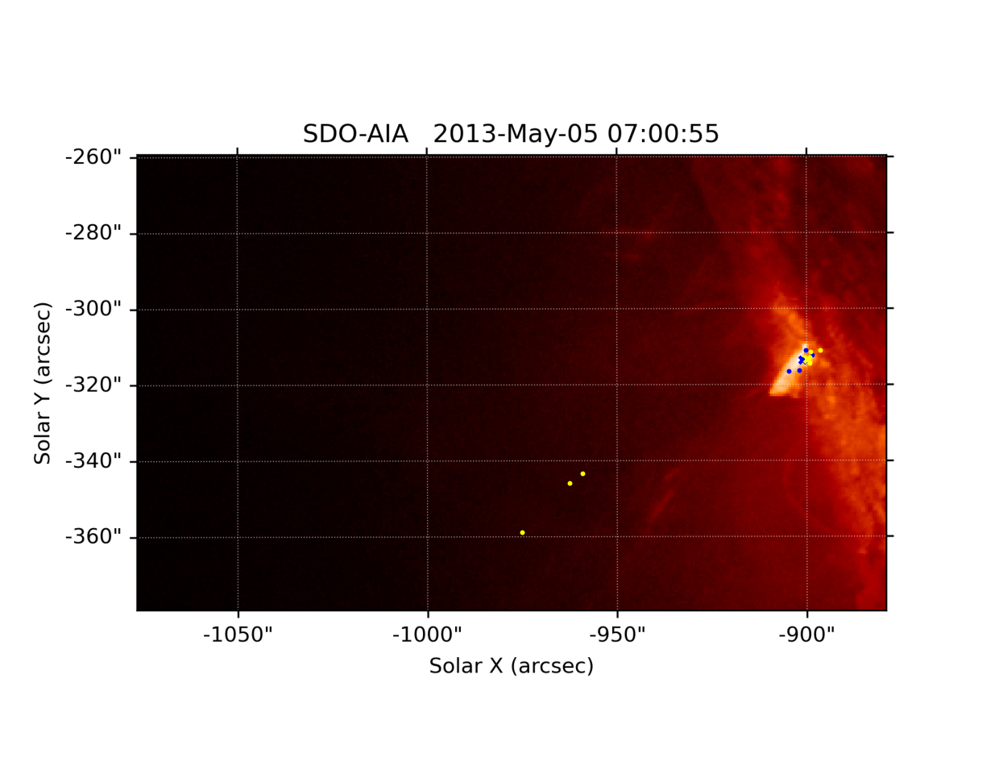

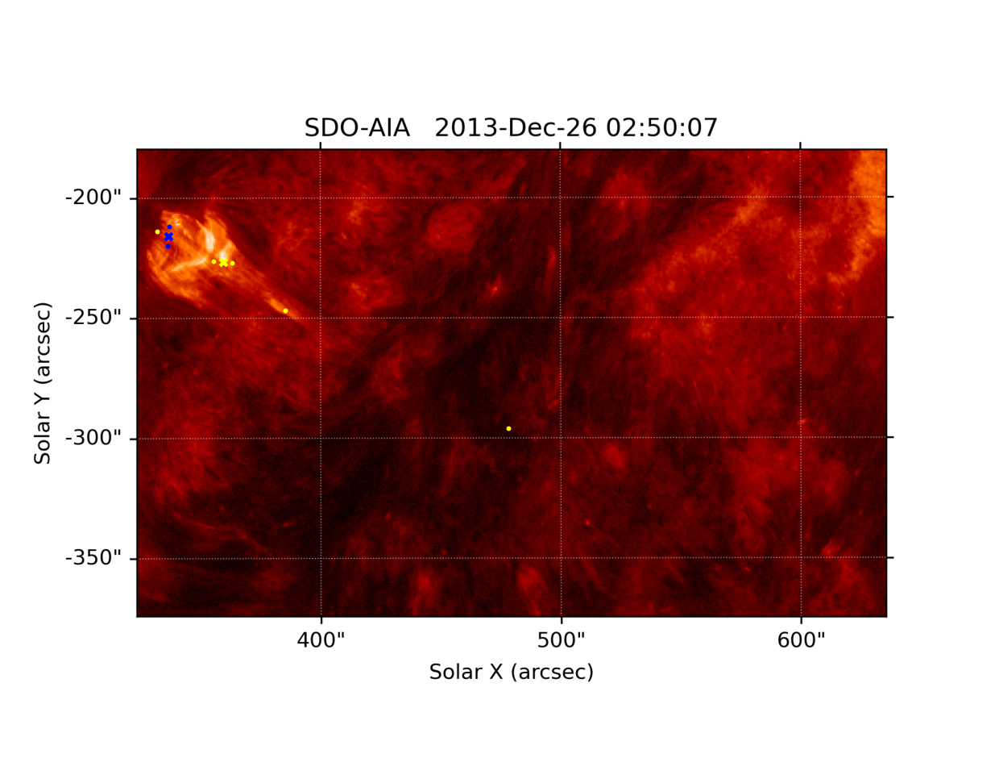

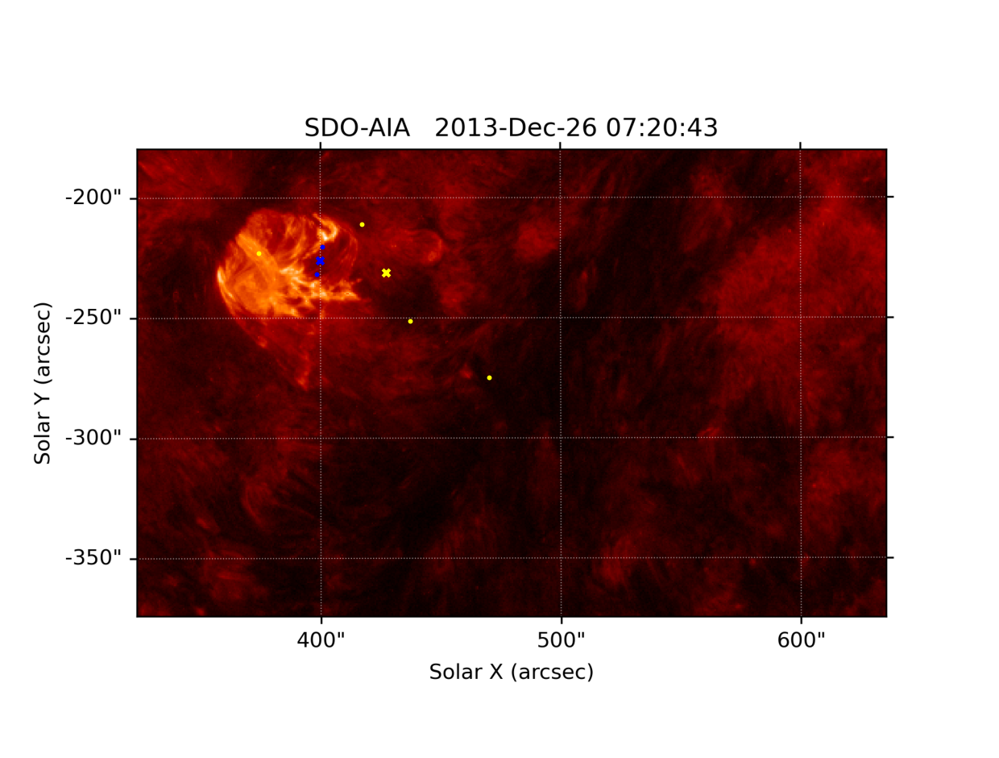

In [28]:
plt.style.use('default')

for i, subject in enumerate(clustered_subs[:25]):
    try:
        x0_i = ast.literal_eval(points0_x[i])
        y0_i = ast.literal_eval(points0_y[i])

        cx0_i = ast.literal_eval(clusters0_x[i])
        cy0_i = ast.literal_eval(clusters0_y[i])

        x1_i = ast.literal_eval(points1_x[i])
        y1_i = ast.literal_eval(points1_y[i])

        cx1_i = ast.literal_eval(clusters1_x[i])
        cy1_i = ast.literal_eval(clusters1_y[i])
    except ValueError:
        continue
    
    subjecti = Subject(int(subject))
    try:
        frame0_url = subjecti.raw['locations'][0]['image/png']
    except KeyError:
        frame0_url = subjecti.raw['locations'][0]['image/jpeg']
    
    img = io.imread(frame0_url)
    
    plt.figure(dpi=200)
    plt.imshow(img)
    
    plt.scatter(x0_i, y0_i, 5.0, marker='.', color='blue')
    plt.scatter(x1_i, y1_i, 5.0, marker='.', color='yellow')
    
    plt.scatter(cx0_i, cy0_i, 10.0, marker='x', color='blue')
    plt.scatter(cx1_i, cy1_i, 10.0, marker='x', color='yellow')
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [8]:
non_clustered_points_mask = data_T1['data.frame0.T1_tool1_clusters_x'].filled()=='None'

non_clustered_subs = data_T1['subject_id'][non_clustered_points_mask]
points_x   = data_T1['data.frame0.T1_tool1_points_x'][non_clustered_points_mask]
points_y   = data_T1['data.frame0.T1_tool1_points_y'][non_clustered_points_mask]

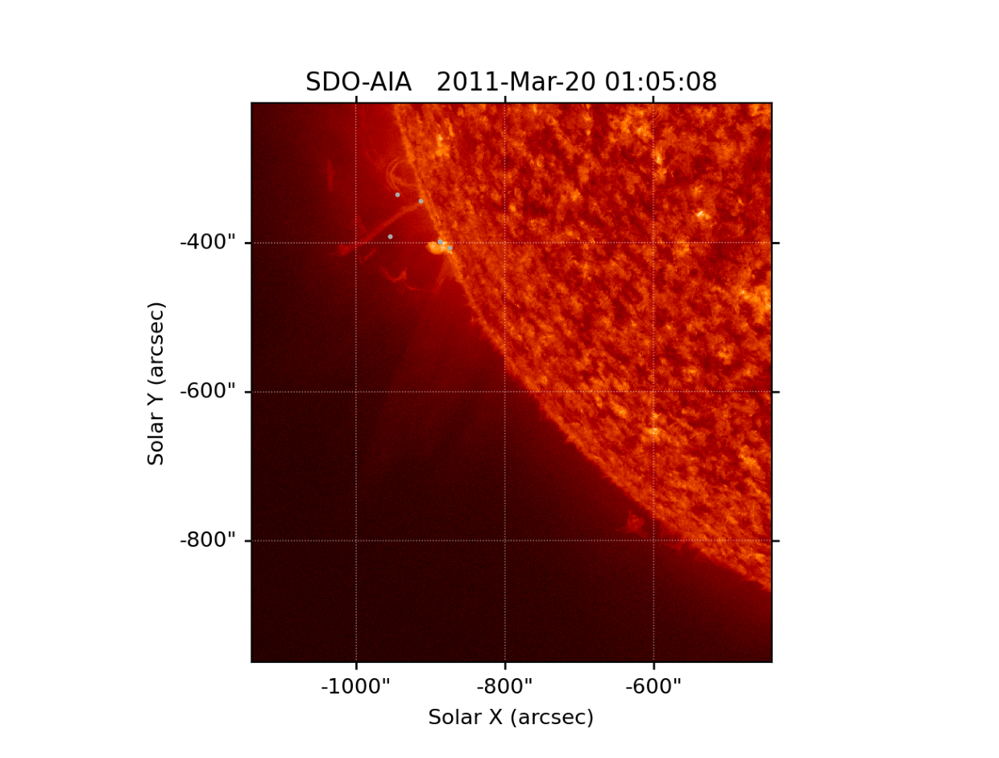

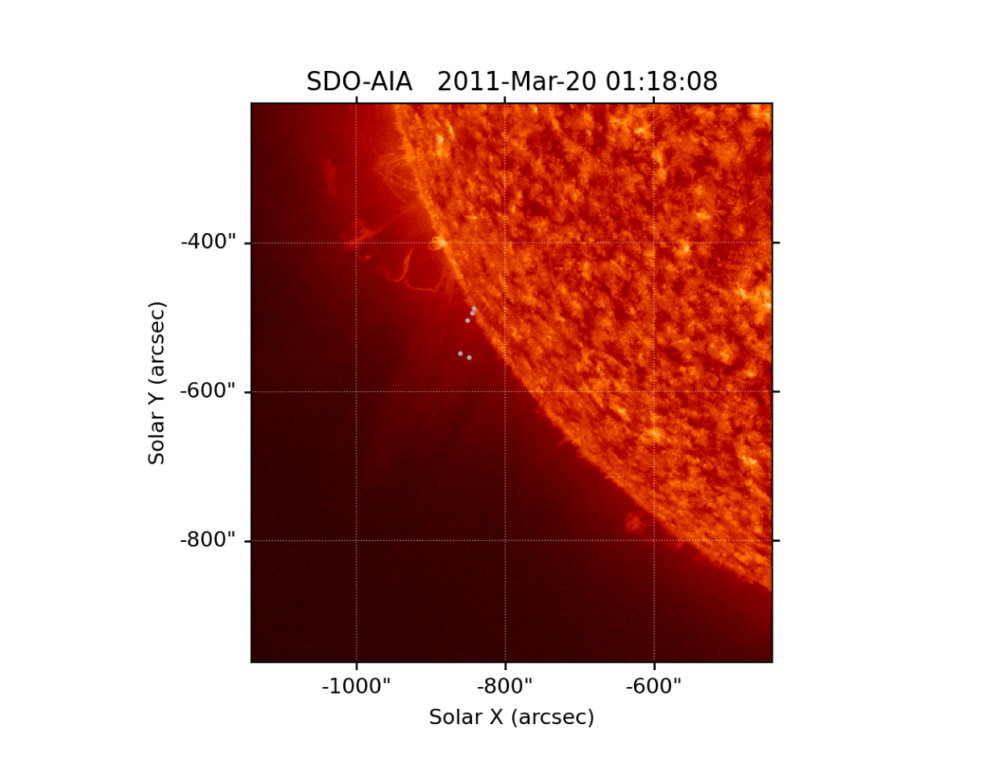

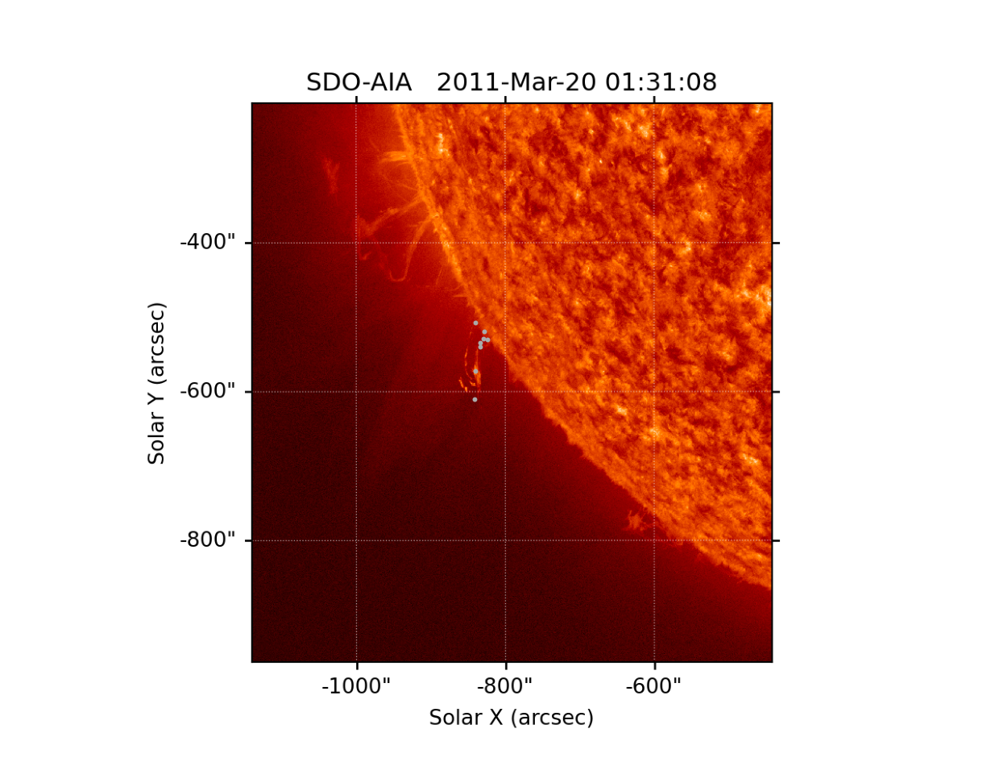

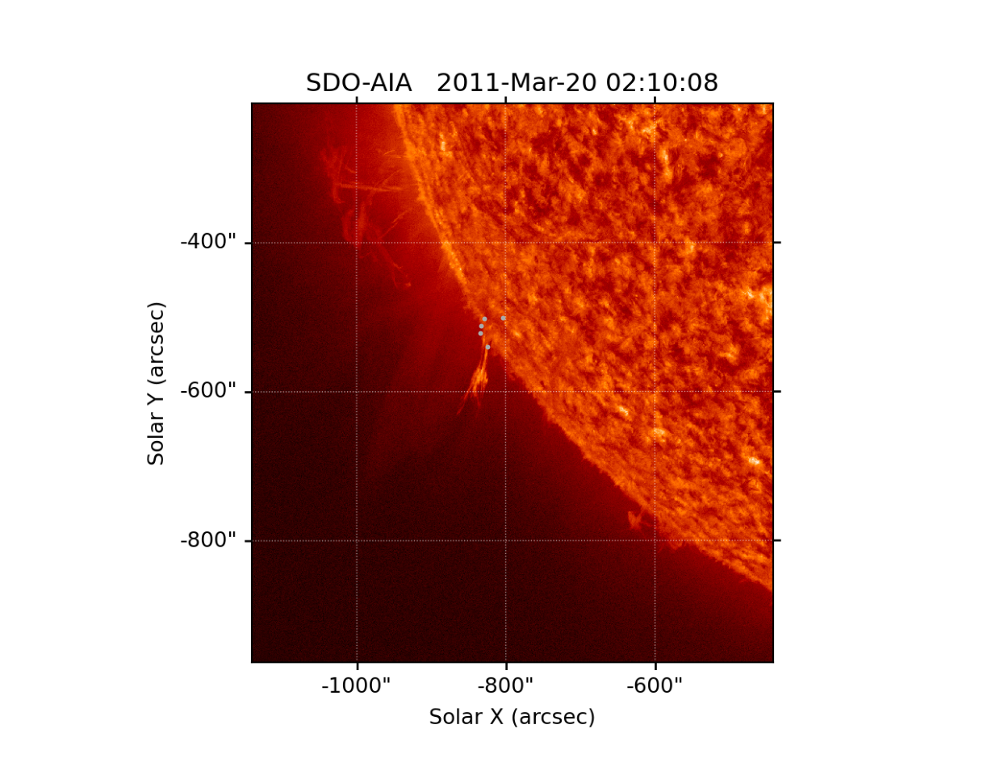

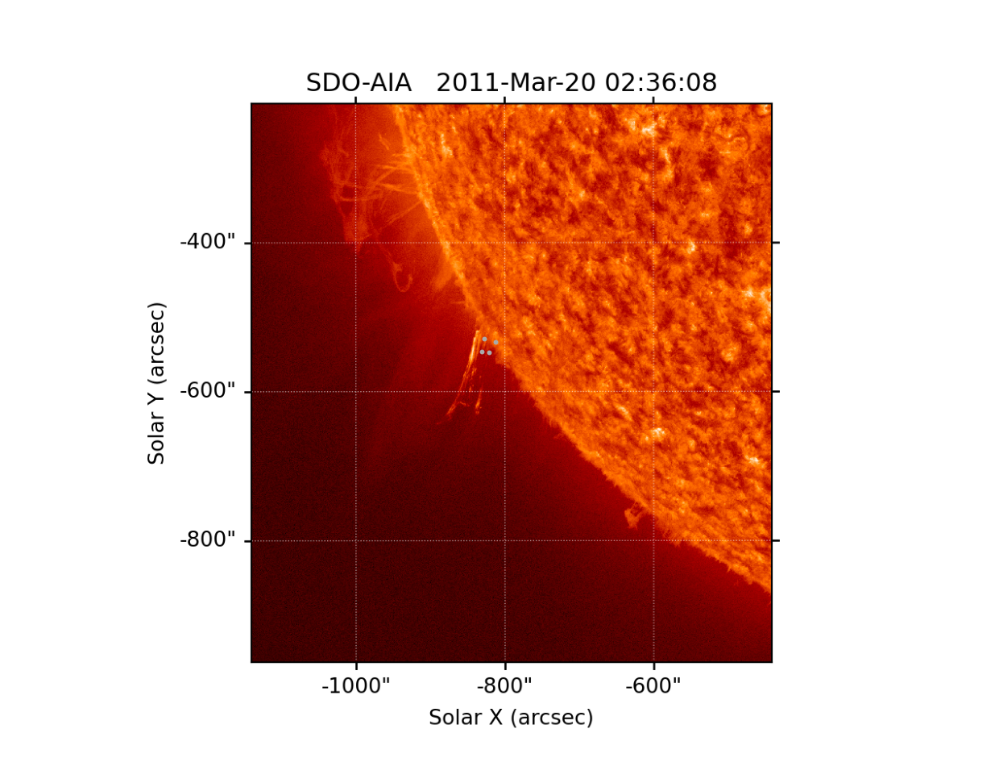

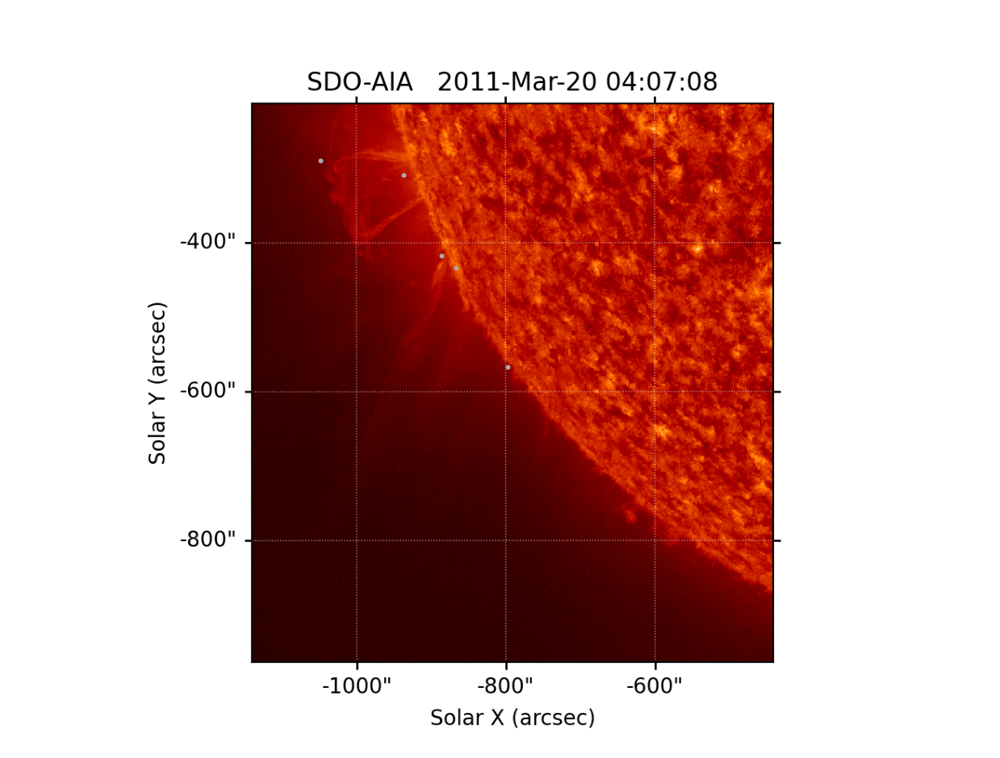

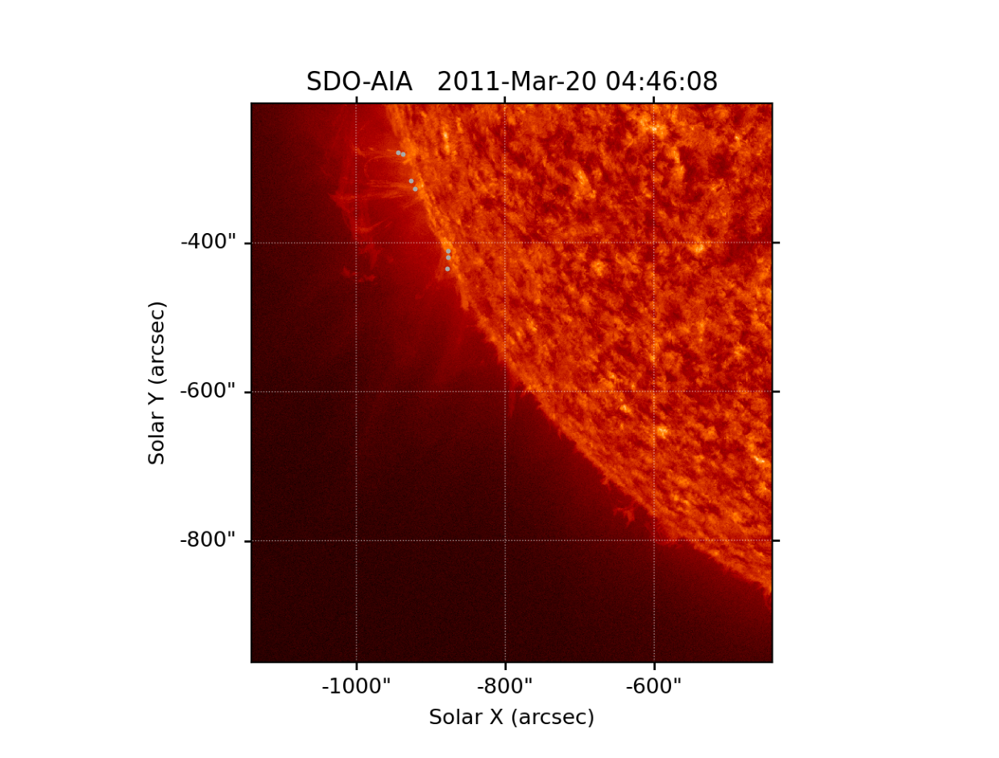

In [10]:
plt.style.use('default')

for i, subject in enumerate(non_clustered_subs[:10]):
    try:
        points_x_i = ast.literal_eval(points_x[i])
        points_y_i = ast.literal_eval(points_y[i])
    except ValueError:
        continue
    
    if len(points_x_i) < 3:
        continue
    
    subjecti = Subject(int(subject))
    try:
        frame0_url = subjecti.raw['locations'][0]['image/png']
    except KeyError:
        frame0_url = subjecti.raw['locations'][0]['image/jpeg']
    
    img = io.imread(frame0_url)
    
    plt.figure(dpi=200)
    plt.imshow(img)
    
    plt.scatter(points_x_i, points_y_i, 5.0, marker='.', color='#aaa')
#     plt.scatter(clusters_x_i, clusters_y_i, 10.0, marker='x', color='blue')
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()